# Imports

In [307]:
import sys
import numpy as np
import librosa as lr
import librosa.display as lrd
import matplotlib.pyplot as plt
from vscode_audio import Audio
from pydub import AudioSegment, effects
import noisereduce as nr
import warnings
from audiomentations import Compose, AddGaussianNoise, TimeStretch, PitchShift, Shift, Gain, PolarityInversion, TimeMask, FrequencyMask, SpecFrequencyMask, RoomSimulator, AddBackgroundNoise
import tensorflow as tf
import tensorflow_io as tfio
import random
if not sys.warnoptions:
    warnings.simplefilter("ignore")
warnings.filterwarnings("ignore", category=DeprecationWarning) 

# Samples

In [2]:
# Samples from different datasets

tess1 = '../Datasets/tess/OAF_angry/OAF_bath_angry.wav'
tess2 = '../Datasets/tess/YAF_happy/YAF_death_happy.wav'

ravdess1 = '../Datasets/ravdess/Actor_03/03-01-02-01-01-01-03.wav'
ravdess2 = '../Datasets/ravdess/Actor_06/03-01-04-02-01-01-06.wav'

crema_d1 = '../Datasets/crema-d/AudioWAV/1001_IEO_NEU_XX.wav'
crema_d2 = '../Datasets/crema-d/AudioWAV/1003_ITH_DIS_XX.wav'

subesco1 = '../Datasets/SUBESCO/F_01_OISHI_S_10_DISGUST_1.wav'
subesco2 = '../Datasets/SUBESCO/M_06_SHUKANTO_S_8_SAD_1.wav'

banglaser1 = '../Datasets/BanglaSER/Actor 01/03-01-01-01-01-01-01.wav'
banglaser2 = '../Datasets/BanglaSER/Actor 02/03-01-01-01-01-01-02.wav'

# Visualization

In [67]:
def compare_waveplot(data1, data2, sr, title1, title2):
  f = plt.figure(figsize=(15, 5))

  ax = f.add_subplot(121)
  lrd.waveshow(data1, sr=sr)
  plt.title(title1)

  ax2 = f.add_subplot(122)
  lrd.waveshow(data2, sr=sr)
  plt.title(title2)
  plt.show()

def compare_spectograph(data1, data2, sr, title1, title2):
  f = plt.figure(figsize=(15, 5))

  ax = f.add_subplot(121)
  x = lr.stft(data1)
  xdb = lr.amplitude_to_db(abs(x))
  plt.title(title1)
  lrd.specshow(xdb, sr=sr, x_axis='time', y_axis='hz')
  plt.colorbar()

  ax2 = f.add_subplot(122)
  x = lr.stft(data2)
  xdb = lr.amplitude_to_db(abs(x))
  plt.title(title1)
  lrd.specshow(xdb, sr=sr, x_axis='time', y_axis='hz')
  plt.colorbar()

# Augmentations

In [275]:
noise = AddGaussianNoise(min_amplitude=0.001, max_amplitude=0.010, p=1)
ts = TimeStretch(min_rate=0.8, max_rate=1.25, p=1)
ps = PitchShift(min_semitones=-2, max_semitones=2, p=1)
shift = Shift(min_fraction=-0.5, max_fraction=0.5, p=1)
gain = Gain(max_gain_in_db=-10, min_gain_in_db=-10, p=1)
pol = PolarityInversion(p=1)
timemask = TimeMask(min_band_part=0.1, max_band_part=1, p=1)
freqmask = FrequencyMask(min_frequency_band=0.1, max_frequency_band=1, p=1)
bgn = AddBackgroundNoise()
specFreqMask = SpecFrequencyMask(min_mask_fraction=0.2, max_mask_fraction=0.8, p=1)

augment = Compose([
    AddGaussianNoise(min_amplitude=0.001, max_amplitude=0.010, p=1),
    TimeStretch(min_rate=0.8, max_rate=1.25, p=1),
    PitchShift(min_semitones=-3, max_semitones=3, p=1),
    Shift(min_fraction=-0.5, max_fraction=0.5, p=1),
])

# TESS

In [184]:
tess1_data, tess1_sr = lr.load(tess1, sr=16000)

### White Noise

In [185]:
tess1_noise = noise(tess1_data, tess1_sr)

In [186]:
# Original
Audio(tess1, sr=tess1_sr)

In [187]:
# With noise
Audio(tess1_noise, tess1_sr, False)

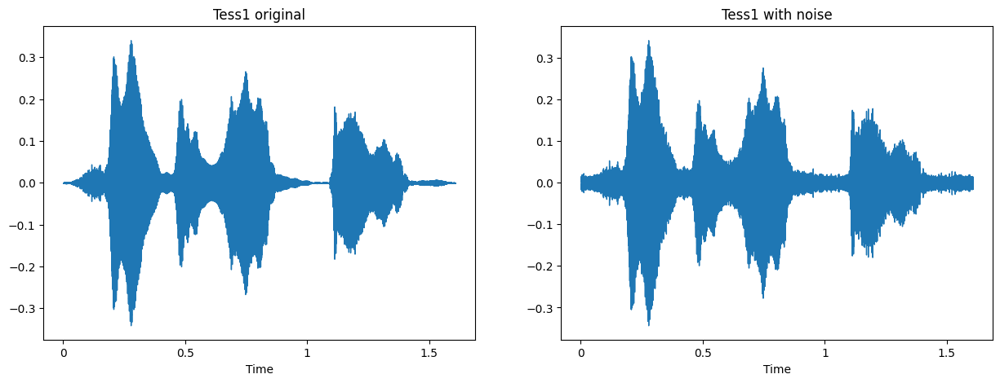

In [188]:
compare_waveplot(tess1_data, tess1_noise, tess1_sr, "Tess1 original", "Tess1 with noise")

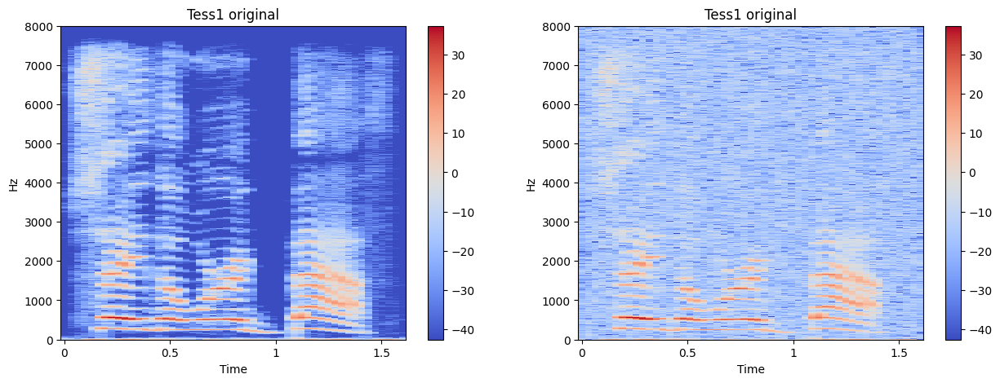

In [189]:
compare_spectograph(tess1_data, tess1_noise, tess1_sr, "Tess1 original", "Tess1 with noise")

### Time Stretch

In [190]:
tess1_ts = ts(tess1_data, tess1_sr)

In [191]:
# Original
Audio(tess1, sr=tess1_sr)

In [192]:
# With time stretch
Audio(tess1_ts, tess1_sr, False)

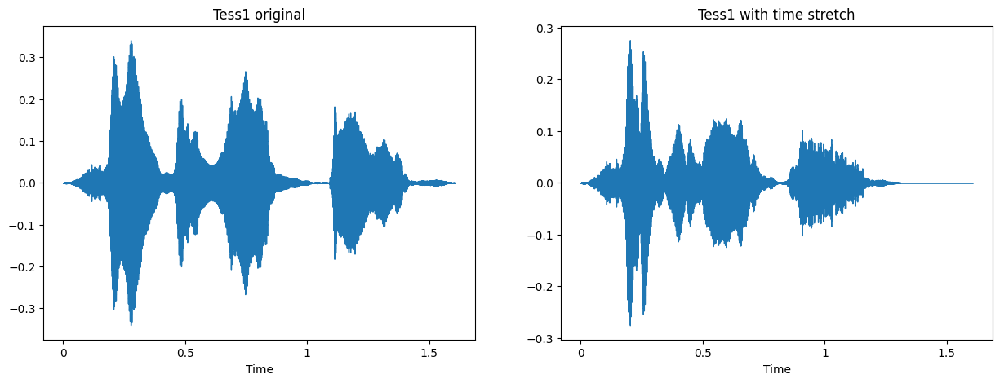

In [193]:
compare_waveplot(tess1_data, tess1_ts, tess1_sr, "Tess1 original", "Tess1 with time stretch")

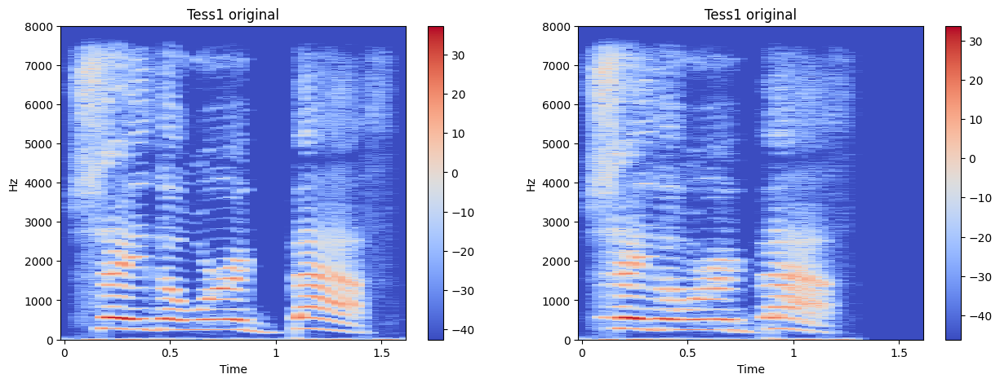

In [194]:
compare_spectograph(tess1_data, tess1_ts, tess1_sr, "Tess1 original", "Tess1 with time stretch")

### Pitch Shift

In [195]:
tess1_ps = ps(tess1_data, tess1_sr)

In [196]:
# Original
Audio(tess1, sr=tess1_sr)

In [197]:
# With pitch shift
Audio(tess1_ps, tess1_sr, False)

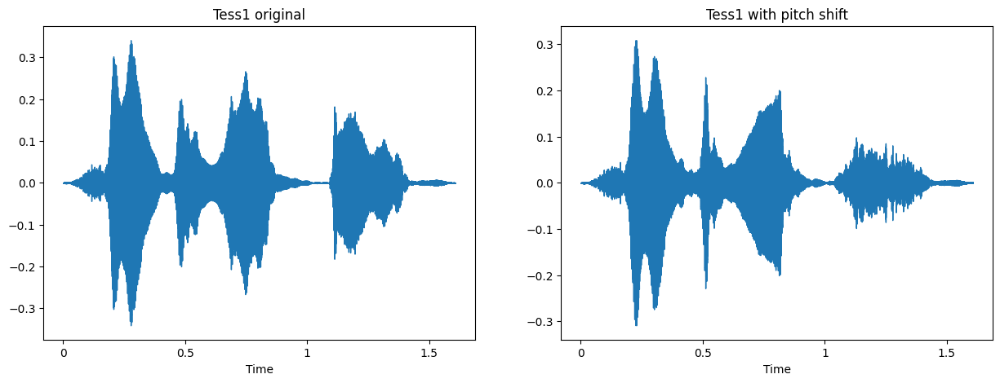

In [198]:
compare_waveplot(tess1_data, tess1_ps, tess1_sr, "Tess1 original", "Tess1 with pitch shift")

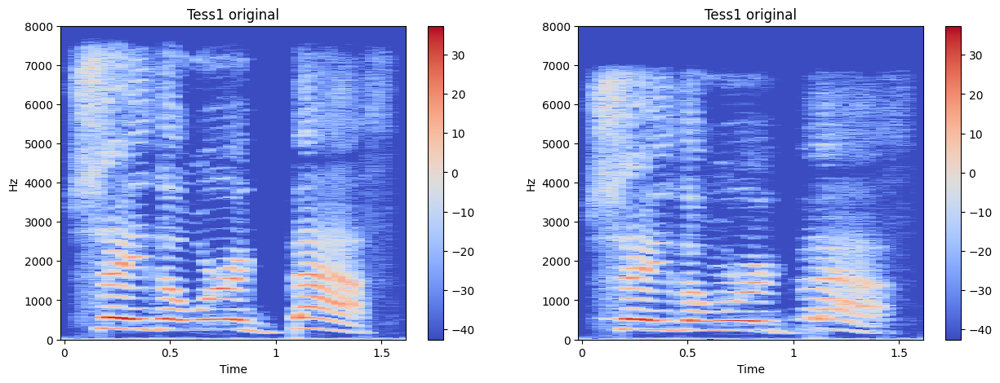

In [199]:
compare_spectograph(tess1_data, tess1_ps, tess1_sr, "Tess1 original", "Tess1 with pitch shift")

### Shifting

In [200]:
tess1_shift = shift(tess1_data, tess1_sr)

In [201]:
# Original
Audio(tess1, sr=tess1_sr)

In [202]:
# With shift
Audio(tess1_shift, tess1_sr, False)

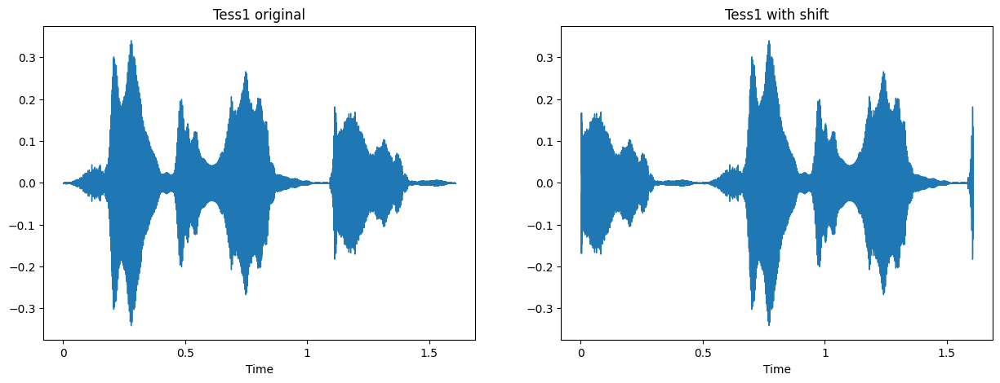

In [203]:
compare_waveplot(tess1_data, tess1_shift, tess1_sr, "Tess1 original", "Tess1 with shift")

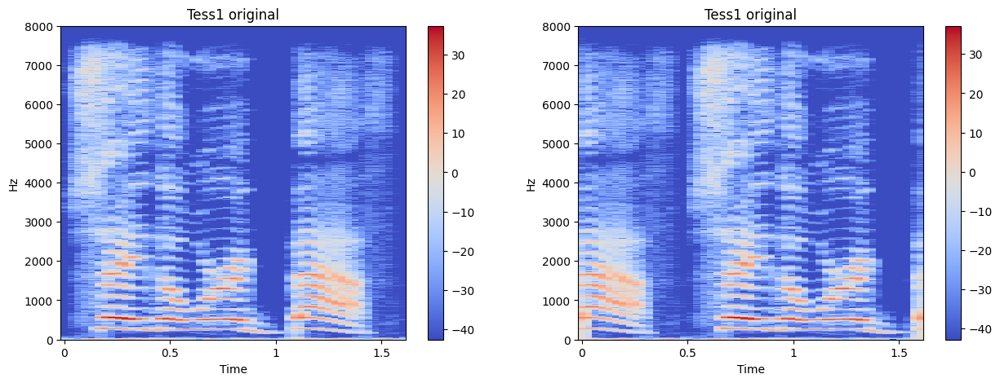

In [204]:
compare_spectograph(tess1_data, tess1_shift, tess1_sr, "Tess1 original", "Tess1 with shift")

### Gain

In [205]:
tess1_gain = gain(tess1_data, tess1_sr)

In [206]:
# Original
Audio(tess1, sr=tess1_sr)

In [207]:
# With gain
Audio(tess1_gain, tess1_sr, False)

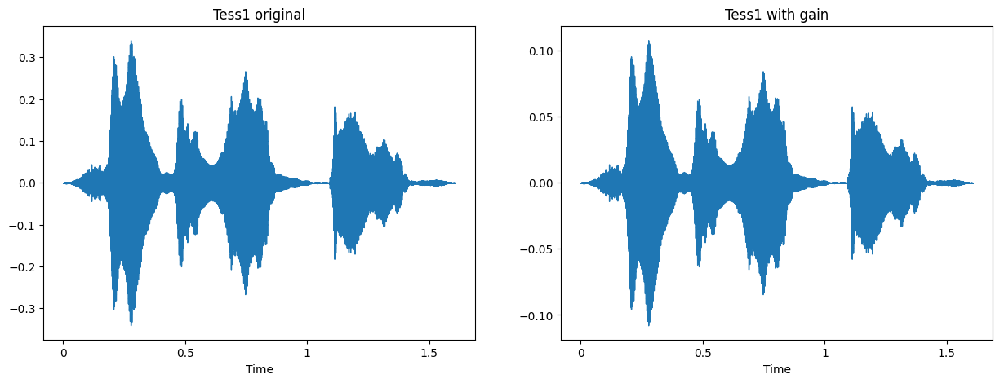

In [208]:
compare_waveplot(tess1_data, tess1_gain, tess1_sr, "Tess1 original", "Tess1 with gain")

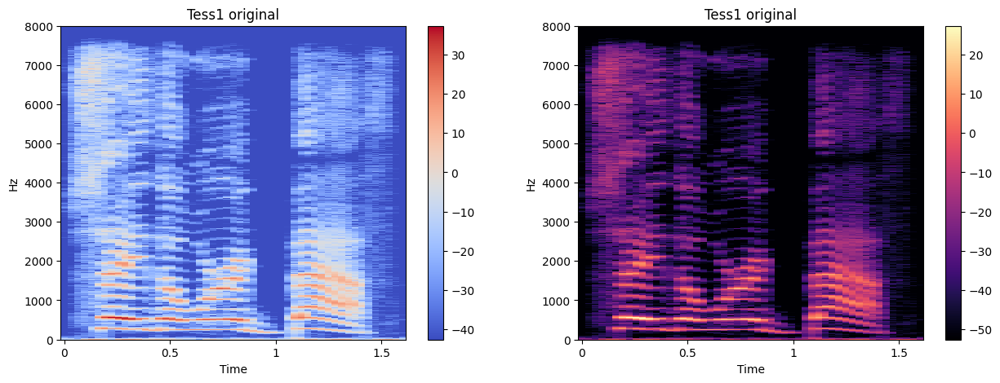

In [209]:
compare_spectograph(tess1_data, tess1_gain, tess1_sr, "Tess1 original", "Tess1 with gain")

### Polarity Inversion

In [210]:
tess1_pol = pol(tess1_data, tess1_sr)

In [211]:
# Original
Audio(tess1, sr=tess1_sr)

In [212]:
# With polarity inversion
Audio(tess1_pol, tess1_sr, False)

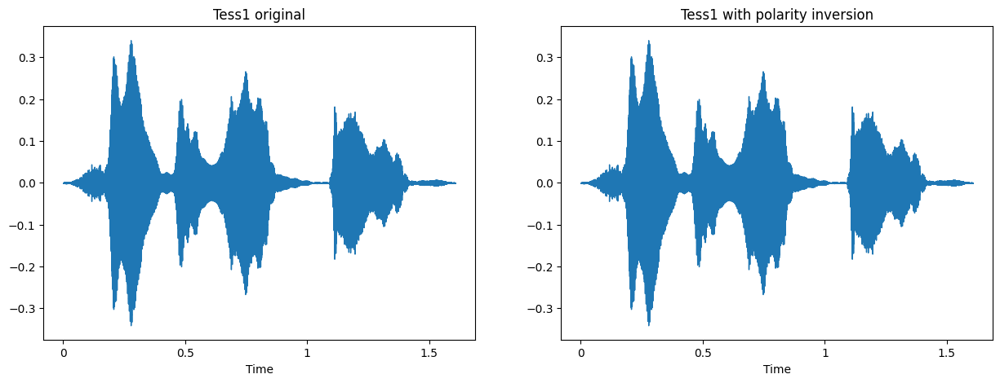

In [213]:
compare_waveplot(tess1_data, tess1_pol, tess1_sr, "Tess1 original", "Tess1 with polarity inversion")

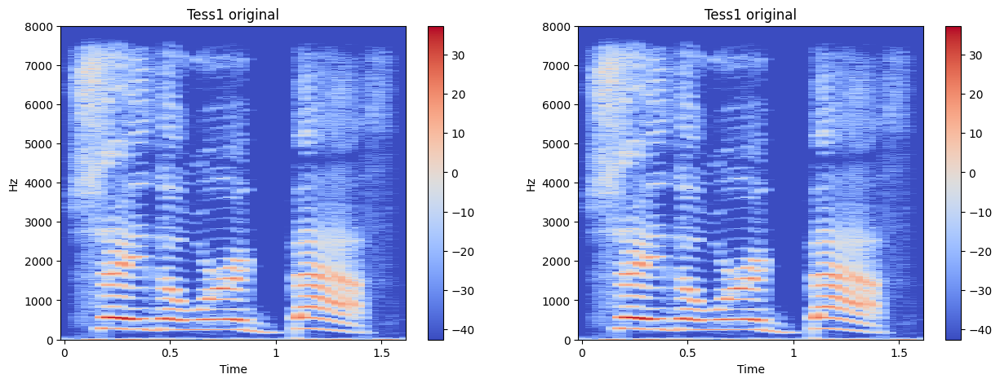

In [214]:
compare_spectograph(tess1_data, tess1_pol, tess1_sr, "Tess1 original", "Tess1 with polarity inversion")

### All together

In [215]:
# All at once
tess1_augment = augment(tess1_data, tess1_sr)
Audio(tess1_augment, tess1_sr, False)

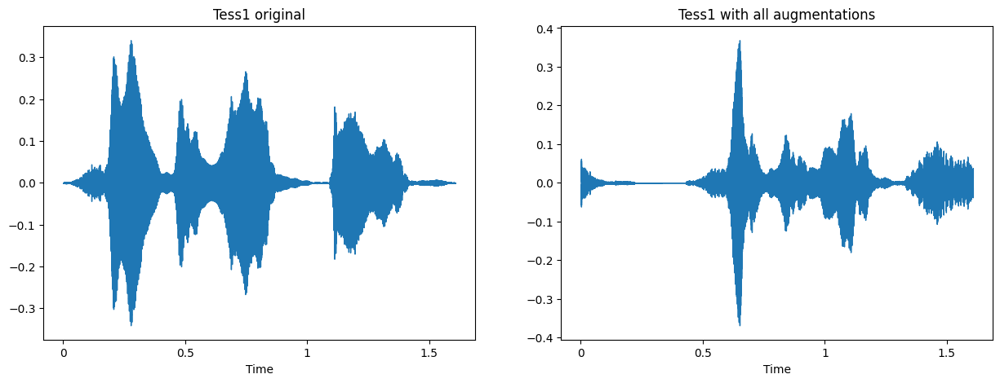

In [216]:
compare_waveplot(tess1_data, tess1_augment, tess1_sr, "Tess1 original", "Tess1 with all augmentations")

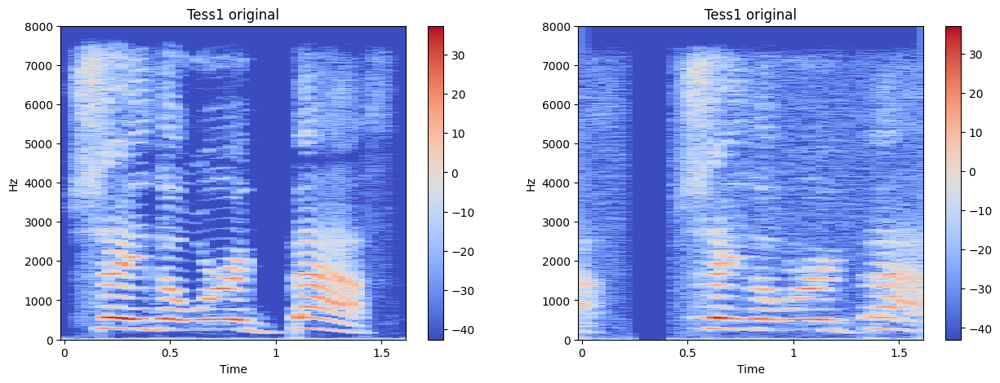

In [226]:
compare_spectograph(tess1_data, tess1_augment, tess1_sr, "Tess1 original", "Tess1 with all augmentations")

### Time Masking

In [242]:
tess1_tm = timemask(tess1_data, tess1_sr)

In [243]:
# Original
Audio(tess1, sr=tess1_sr)

In [244]:
# With time mask
Audio(tess1_tm, tess1_sr, False)

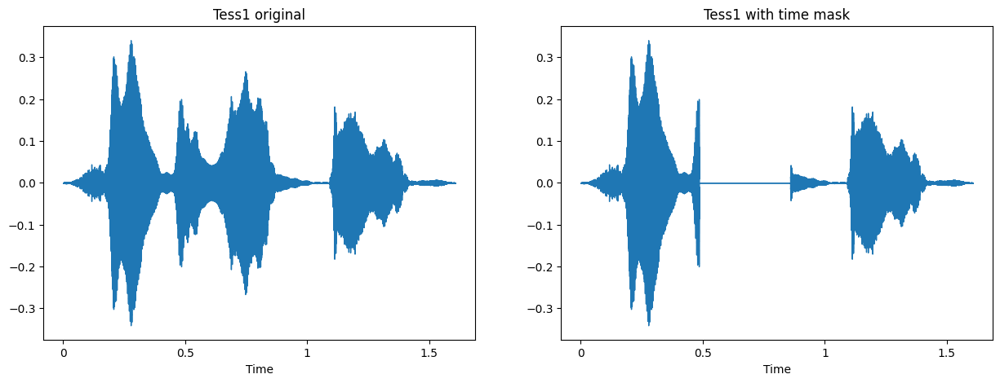

In [246]:
compare_waveplot(tess1_data, tess1_tm, tess1_sr, "Tess1 original", "Tess1 with time mask")

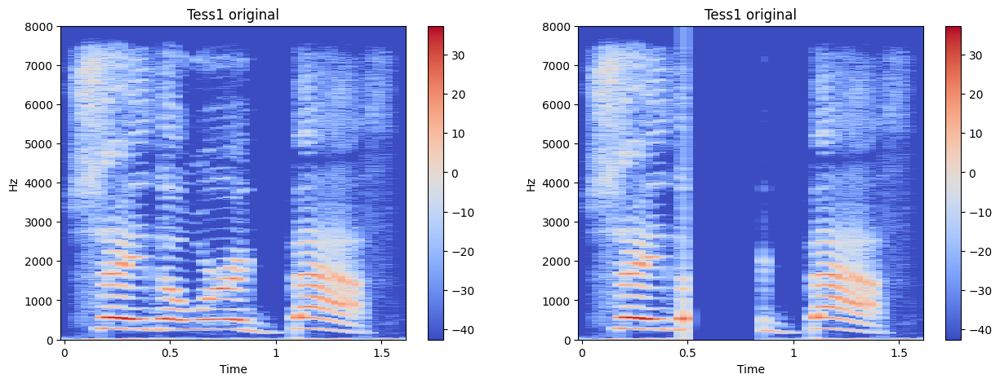

In [245]:

compare_spectograph(tess1_data, tess1_tm, tess1_sr, "Tess1 original", "Tess1 with time mask")

### Frequency Masking

In [247]:
tess1_fm = freqmask(tess1_data, tess1_sr)

In [250]:
# Original
Audio(tess1, sr=tess1_sr)

In [251]:
# With frequency mask
Audio(tess1_fm, tess1_sr, False)

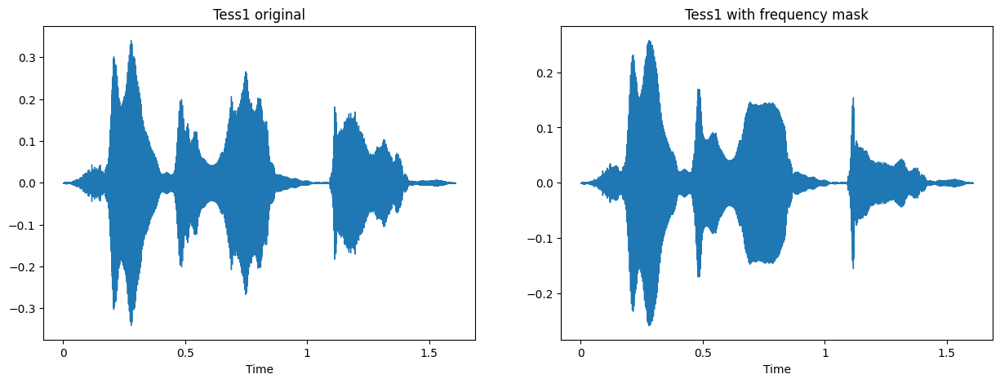

In [248]:
compare_waveplot(tess1_data, tess1_fm, tess1_sr, "Tess1 original", "Tess1 with frequency mask")

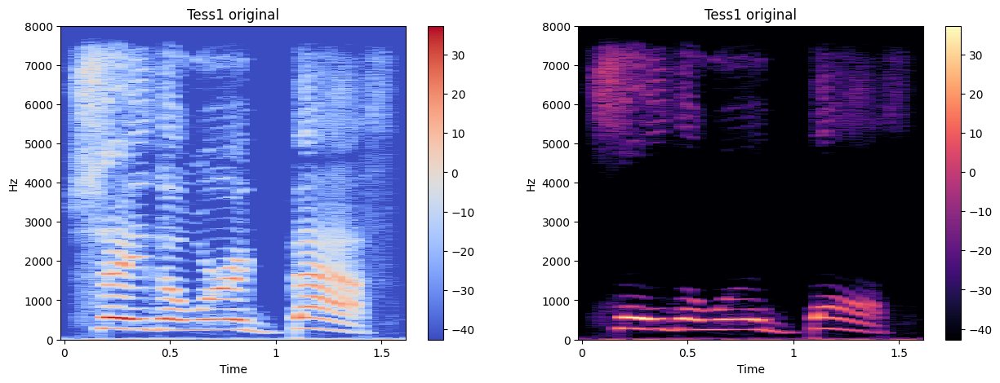

In [249]:
compare_spectograph(tess1_data, tess1_fm, tess1_sr, "Tess1 original", "Tess1 with frequency mask")

# RAVDESS

In [ ]:
ravdess1_data, ravdess1_sr = lr.load(ravdess2)

In [ ]:
ravdess1_noise = noise(ravdess1_data, ravdess1_sr)
ravdess1_ts = ts(ravdess1_data, ravdess1_sr)
ravdess1_ps = ps(ravdess1_data, ravdess1_sr)
ravdess1_shift = shift(ravdess1_data, ravdess1_sr)
ravdess1_gain = gain(ravdess1_data, ravdess1_sr)
ravdess1_pol = pol(ravdess1_data, ravdess1_sr)
ravdess1_tm = timemask(ravdess1_data, ravdess1_sr)
ravdess1_fm = freqmask(ravdess1_data, ravdess1_sr)

In [ ]:
# Original
Audio(ravdess2, sr=ravdess1_sr)

In [ ]:
# With noise
Audio(ravdess1_noise, ravdess1_sr, False)

In [ ]:
# With time stretch
Audio(ravdess1_ts, ravdess1_sr, False)

In [ ]:
# With Pitch shift
Audio(ravdess1_ps, ravdess1_sr, False)

In [ ]:
# With gain
Audio(ravdess1_gain, ravdess1_sr, False)

In [ ]:
# With polarity inversion
Audio(ravdess1_pol, ravdess1_sr, False)

In [ ]:
# With time mask
Audio(ravdess1_tm, ravdess1_sr, False)

In [ ]:
# With frequency mask
Audio(ravdess1_fm, ravdess1_sr, False)